# Age and gender prediction with UTKFace dataset

In this projet two fairly simple problems are being solved - gender classification and age classification from an up-close image of a person ([UTKFace Kaggle dataset](https://www.kaggle.com/datasets/jangedoo/utkface-new)). But instead of making two different models, the task will be to make one model that does both of these tasks using a multi-task learning method. This will involve building a deep learning model that consists of a CNN pre-trained architecture that will be used as a feature extractor and two task specific neural net heads attached at the end of a CNN model, one for classifying the gender and one for predicting the age.

After building a model there will be an error analysis and model interpretability to see what errors are being made and to analyze the model from the ethical point of view and see what sort of dangers and caveats such models can have.

## Data preparation

In [2]:
try:
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import seaborn as sns
    import os
    from collections import defaultdict, OrderedDict

    import torch
    import torch.nn as nn
    from torch.utils.data import DataLoader, Dataset
    import torchvision
    from torchvision.io import read_image
    import pytorch_lightning as pl
    import torchmetrics as tm

    from sklearn.model_selection import train_test_split

    import gc

    #import shap

    from lime.lime_image import LimeImageExplainer
    from skimage.segmentation import mark_boundaries

except ImportError:
    !pip install lightning
    #!pip install shap
    !pip install lime
    pass

In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!mkdir /content/kaggle/
!mkdir /content/kaggle/input/
!mkdir /content/kaggle/input/utkface-new
!unzip /content/gdrive/MyDrive/Datasets/utkface.zip -d /content/kaggle/input/utkface-new/

In [3]:
path = '/content/kaggle/input/utkface-new/utkface'

path1 = path+'/UTKFace'
files1 = [os.path.join(path1, f) for f in os.listdir(path1) if f.endswith('.jpg')]

path2 = path+'/crop_part1'
files2 = [os.path.join(path2, f) for f in os.listdir(path2) if f.endswith('.jpg')]

utkface_files = [*files1, *files2]

utkface_df = pd.DataFrame()

utkface_df['path'] = utkface_files
utkface_df['age'] = utkface_df['path'].apply(
    lambda x: int(x.split('/')[-1].split('_')[0]))

utkface_df['gender'] = utkface_df['path'].apply(
    lambda x: int(x.split('/')[-1].split('_')[1]) \
    if x.split('/')[-1].split('_')[1] in ['0', '1'] \
    else np.nan)

utkface_df.dropna(inplace=True)

utkface_df['race'] = utkface_df['path'].apply(
    lambda x: int(x.split('/')[-1].split('_')[2]) \
    if x.split('/')[-1].split('_')[2] in ['2', '1', '3', '0', '4'] \
    else np.nan)

utkface_df.head()

,path,age,gender,race
0,/kaggle/input/utkface-new/UTKFace/26_0_2_20170...,26,0.0,2.0
1,/kaggle/input/utkface-new/UTKFace/22_1_1_20170...,22,1.0,1.0
2,/kaggle/input/utkface-new/UTKFace/21_1_3_20170...,21,1.0,3.0
3,/kaggle/input/utkface-new/UTKFace/28_0_0_20170...,28,0.0,0.0
4,/kaggle/input/utkface-new/UTKFace/17_1_4_20170...,17,1.0,4.0


In [4]:
train_val_df, test_df = train_test_split(utkface_df, test_size=0.1, random_state=0)
train_df, valid_df = train_test_split(train_val_df, test_size=0.2, random_state=0)

In [ ]:
print(f'Dataset size - {utkface_df.shape[0]}')
print(f'Train size - {train_df.shape[0]}, percentage - {round(100*train_df.shape[0]/utkface_df.shape[0], 2)}%')
print(f'Validation size - {valid_df.shape[0]}, percentage - {round(100*valid_df.shape[0]/utkface_df.shape[0], 2)}%')
print(f'Test size - {test_df.shape[0]}, percentage - {round(100*test_df.shape[0]/utkface_df.shape[0], 2)}%')

Dataset size - 33487
Train size - 24110, percentage - 72.0%
Validation size - 6028, percentage - 18.0%
Test size - 3349, percentage - 10.0%


## EDA

In [5]:
train_df.describe()

,age,gender,race
count,24110.000000,24110.000000,24106.00000
mean,32.237702,0.498963,1.26006
std,21.488373,0.500009,1.39023
min,1.000000,0.000000,0.00000
25%,18.000000,0.000000,0.00000
50%,28.000000,0.000000,1.00000
75%,45.000000,1.000000,2.00000
max,116.000000,1.000000,4.00000


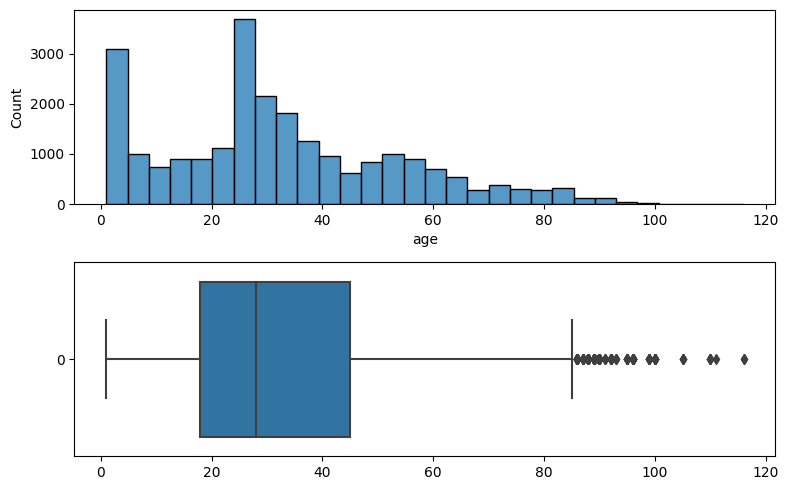

In [ ]:
fig, ax = plt.subplots(2,1,figsize=(8,5))

sns.histplot(train_df['age'], bins=30, ax=ax[0])
sns.boxplot(train_df['age'], orient='h', ax=ax[1])
plt.tight_layout()
plt.show()

The age range seems to be quite wide with some outliers on the older end. Most samples are between (little below) 20 and (little above) 40 range and there is also a higher number of samples in the infancy part and mid 20s.

In [6]:
train_df['gender'].value_counts()

0.0    12080
1.0    12030
Name: gender, dtype: int64

In [7]:
gender_dict = {
    0:'Male',
    1:'Female'
}

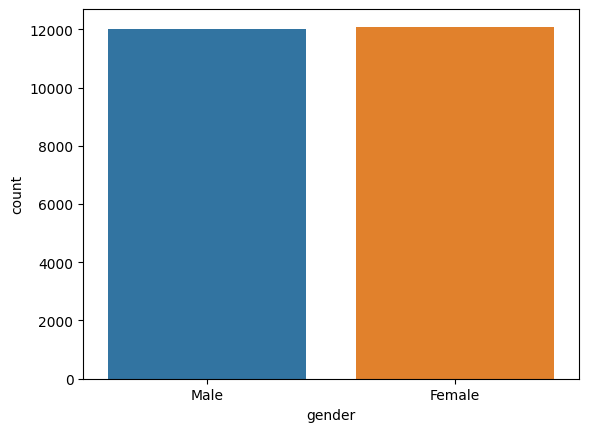

In [ ]:
sns.countplot(x=train_df['gender'].apply(lambda x: gender_dict[x]))
plt.show()

There seems to be an equal balance between the two genders.

In [8]:
race_dict = {
    0:'White',
    1:'Black',
    2:'Asian',
    3:'Indian',
    4:'Others like Hispanic, Latino, Middle Eastern'
}

In [ ]:
df = train_df['race'].dropna().apply(lambda x: race_dict[x])
df.value_counts()

White                                           11029
Indian                                           3903
Asian                                            3624
Black                                            3541
Others like Hispanic, Latino, Middle Eastern     2011
Name: race, dtype: int64

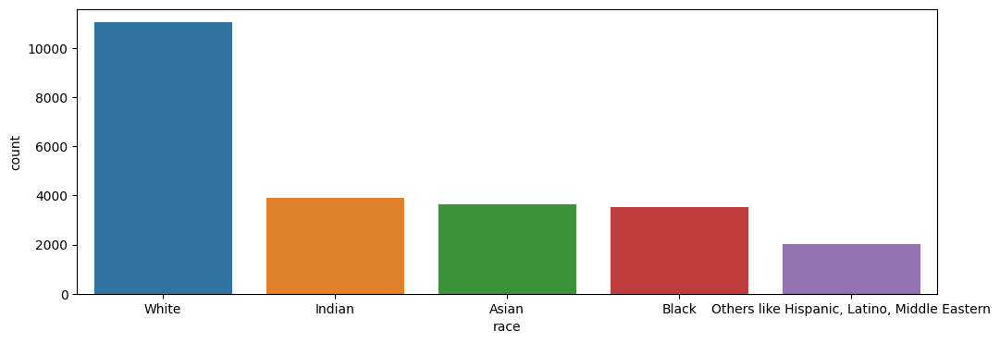

In [ ]:
plt.figure(figsize=(12,4))
sns.countplot(x=df, order=df.value_counts().index)
plt.show()

Most images seems to be from white race. Other race groups might be under-reprensented and predictions might be worse on them especialy races from Others category.

### Male image samples

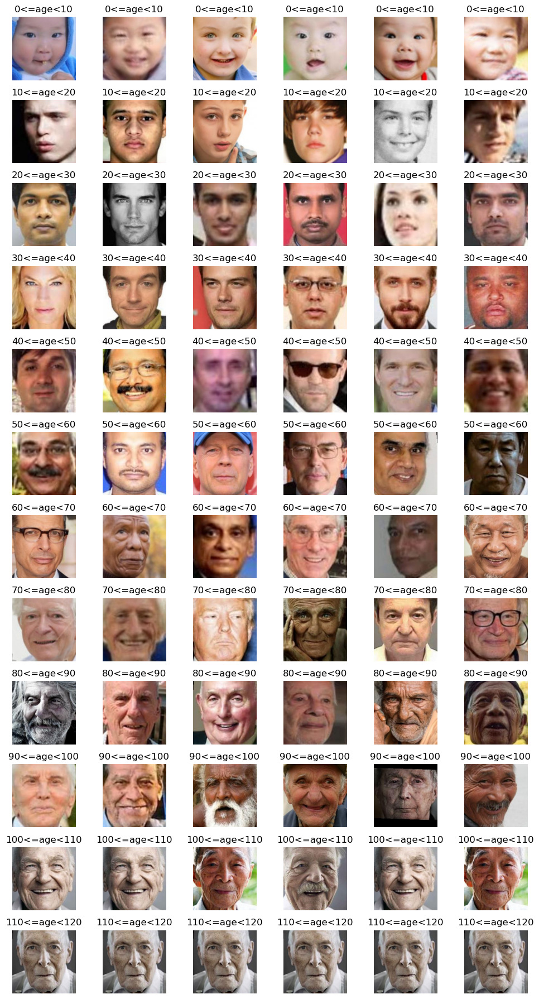

In [ ]:
nrows, ncols = 12, 6

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10,18))

curr_age = 0

for i in range(nrows):
    sample_img = train_df[
        (train_df['age']>=curr_age) & (train_df['age']<curr_age+10) &
        (train_df['gender']==0)
    ]['path'].sample(ncols, replace=True if curr_age>=100 else False).values

    for j in range(ncols):
        img = plt.imread(sample_img[j])
        ax[i][j].imshow(img)
        ax[i][j].set_title(f'{curr_age}<=age<{curr_age+10}')
        ax[i][j].axis("off")

    curr_age += 10

plt.tight_layout()

We can see that among male sample images there are a few female faces, which indicates that there are mislabeled data.

### Female image samples

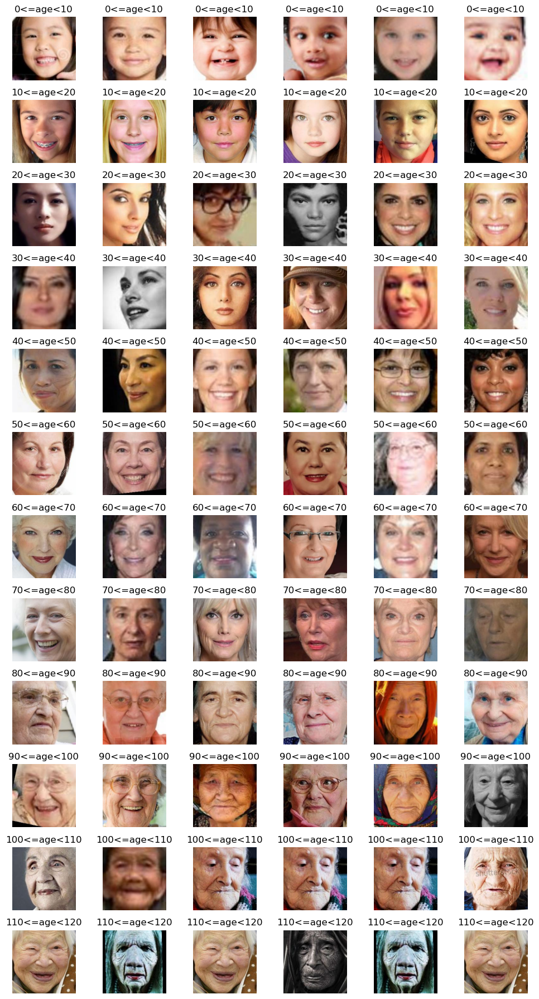

In [ ]:
nrows, ncols = 12, 6

fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10,18))

curr_age = 0

for i in range(nrows):
    sample_img = train_df[
        (train_df['age']>=curr_age) & (train_df['age']<curr_age+10) &
        (train_df['gender']==1)
    ]['path'].sample(ncols, replace=True if curr_age>=100 else False).values

    for j in range(ncols):
        img = plt.imread(sample_img[j])
        ax[i][j].imshow(img)
        ax[i][j].set_title(f'{curr_age}<=age<{curr_age+10}')
        ax[i][j].axis("off")

    curr_age += 10

plt.tight_layout()

After observing random samples for males and females there doesn't seem to be any other problems apart from some images being rather blurry and more rarely having traces of watermarks on them. Also there could be some uncertainty with gender predictions for the very young people as going towards infancy it might be hard to know the gender of a person from a face image even for a human.

## Training

For experimentation the following pretrained CNN architectures are chosen, because of their performance on ImageNet and that they don't require too much resources as some models do:
- resnet18;
- resnet50;
- mobilenet_v3_large;
- mobilenet_v3_small;
- efficientnet_b0;
- efficientnet_b1;

In [ ]:
!cp /content/gdrive/MyDrive/TuringCollege/TC_projects/m4_s3_project/utkface_utils.py /content/
!cp /content/gdrive/MyDrive/TuringCollege/TC_projects/m4_s3_project/utkface_data.py /content/
!cp /content/gdrive/MyDrive/TuringCollege/TC_projects/m4_s3_project/utkface_model.py /content/

In [10]:
from utkface_utils import *
from utkface_data import *
from utkface_model import *

In [11]:
EPOCHS = 30
BATCH_SIZE = 32
LEARNING_RATE = 1e-3
MODEL_NAME = 'utkface'
CM_PLOT_PERIOD = 100

In [ ]:
!rm -rf /content/logs/

In [ ]:
!unzip /content/gdrive/MyDrive/TuringCollege/TC_projects/m4_s3_project/{MODEL_NAME}_logs.zip -d /content/

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=logs/{MODEL_NAME}/

<IPython.core.display.Javascript object>

In [12]:
VERSIONS = ['resnet18','resnet50','mobilenet_v3_large','mobilenet_v3_small',
            'efficientnet_b0','efficientnet_b1']





		CURRENT MODEL TRAINING - resnet18






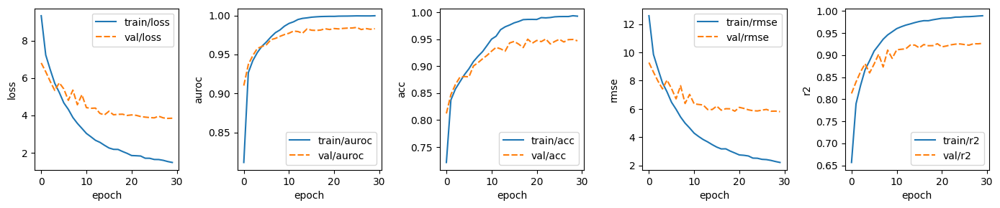





		CURRENT MODEL TRAINING - resnet50






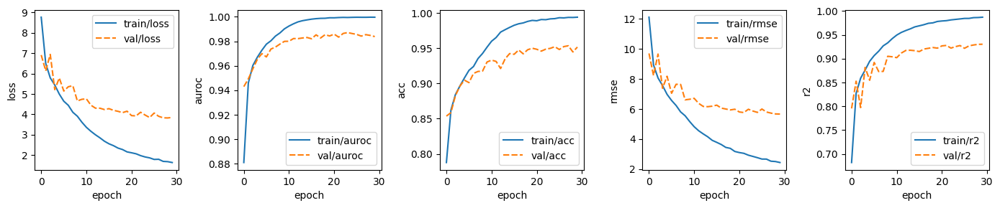





		CURRENT MODEL TRAINING - mobilenet_v3_large






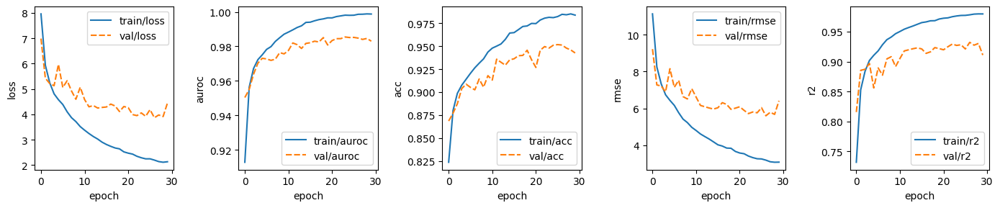





		CURRENT MODEL TRAINING - mobilenet_v3_small






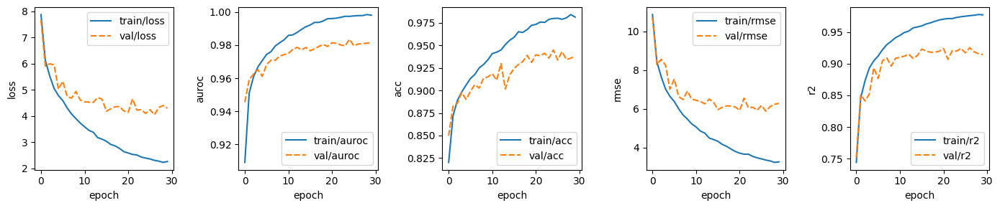





		CURRENT MODEL TRAINING - efficientnet_b0






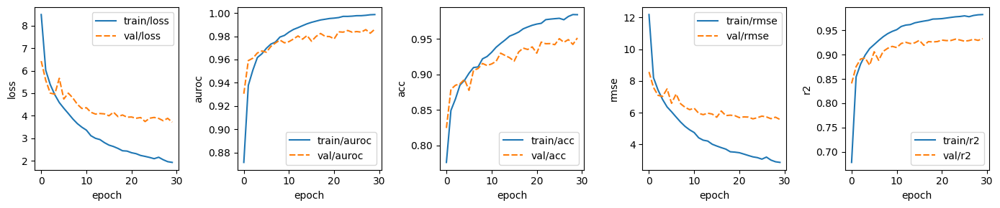





		CURRENT MODEL TRAINING - efficientnet_b1






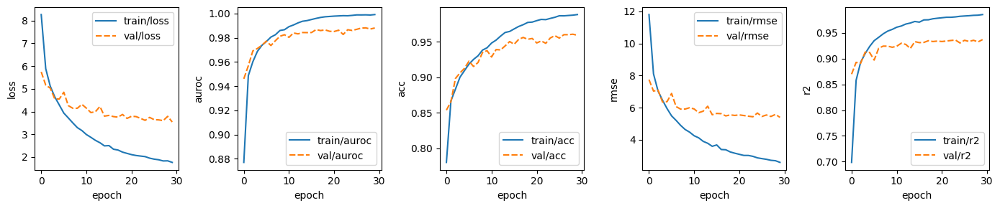

In [ ]:
for version in VERSIONS:
    print(f'\n\n\t\tCURRENT MODEL TRAINING - {version}\n\n')

    model = UTKFaceModel(
        train_df,
        valid_df,
        test_df,
        learning_rate=LEARNING_RATE,
        batch_size=BATCH_SIZE,
        cm_period=CM_PLOT_PERIOD,
        backbone=version,
    )

    train_ptl_model(
        model=model,
        model_name=MODEL_NAME,
        version=version,
        epochs=EPOCHS,
        print_model=True
    )

    del model
    gc.collect()
    torch.cuda.empty_cache()

We can see that for all models, after 15 epochs or so, the loss and other metrics start to plateau.

In [ ]:
!zip -r /content/gdrive/MyDrive/TuringCollege/TC_projects/m4_s3_project/{MODEL_NAME}_logs.zip logs/

## Evaluation

In [13]:
logs_path = '/kaggle/input/utkfacelogs/logs/utkface'
best_ckpts = {v:f'{logs_path}/{v}/best_ckpt/'+os.listdir(f'{logs_path}/{v}/best_ckpt/')[0] for v in VERSIONS}
best_ckpts

{'resnet18': '/kaggle/input/utkfacelogs/logs/utkface/resnet18/best_ckpt/utkface_epoch28-val_loss3.84.ckpt',
 'resnet50': '/kaggle/input/utkfacelogs/logs/utkface/resnet50/best_ckpt/utkface_epoch28-val_loss3.82.ckpt',
 'mobilenet_v3_large': '/kaggle/input/utkfacelogs/logs/utkface/mobilenet_v3_large/best_ckpt/utkface_epoch26-val_loss3.87.ckpt',
 'mobilenet_v3_small': '/kaggle/input/utkfacelogs/logs/utkface/mobilenet_v3_small/best_ckpt/utkface_epoch26-val_loss4.04.ckpt',
 'efficientnet_b0': '/kaggle/input/utkfacelogs/logs/utkface/efficientnet_b0/best_ckpt/utkface_epoch29-val_loss3.72.ckpt',
 'efficientnet_b1': '/kaggle/input/utkfacelogs/logs/utkface/efficientnet_b1/best_ckpt/utkface_epoch29-val_loss3.54.ckpt'}



		CURRENT MODEL TESTING - resnet18


TEST SET



Testing: 0it [00:00, ?it/s]

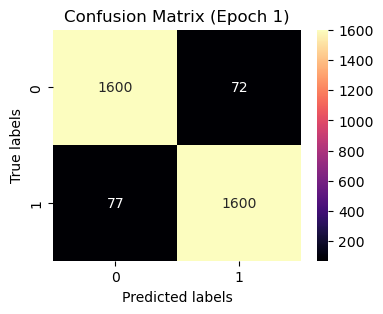

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9555091261863708     │
│        test/auroc         │     0.987841784954071     │
│         test/loss         │    3.8169844150543213     │
│          test/r2          │    0.9254834651947021     │
│         test/rmse         │     5.913937091827393     │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 3.69 s, sys: 1.09 s, total: 4.78 s
Wall time: 11.8 s


		CURRENT MODEL TESTING - resnet50


TEST SET



Testing: 0it [00:00, ?it/s]

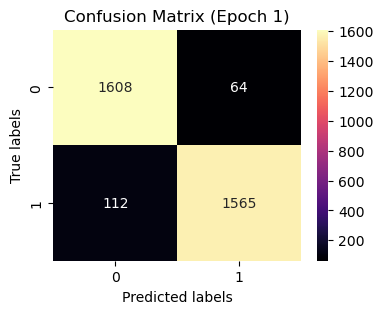

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9474470019340515     │
│        test/auroc         │    0.9861313104629517     │
│         test/loss         │     3.758246421813965     │
│          test/r2          │    0.9302622675895691     │
│         test/rmse         │     5.72116231918335      │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 9.41 s, sys: 1.48 s, total: 10.9 s
Wall time: 14.5 s


		CURRENT MODEL TESTING - mobilenet_v3_large


TEST SET



Testing: 0it [00:00, ?it/s]

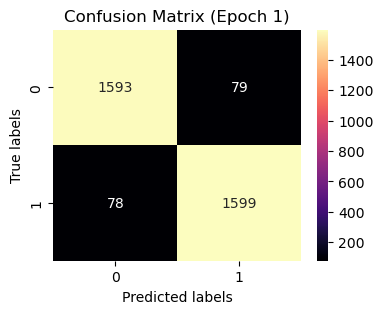

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9531203508377075     │
│        test/auroc         │    0.9869905114173889     │
│         test/loss         │     3.826521873474121     │
│          test/r2          │    0.9277054071426392     │
│         test/rmse         │     5.825097560882568     │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 3.97 s, sys: 1.09 s, total: 5.06 s
Wall time: 11.6 s


		CURRENT MODEL TESTING - mobilenet_v3_small


TEST SET



Testing: 0it [00:00, ?it/s]

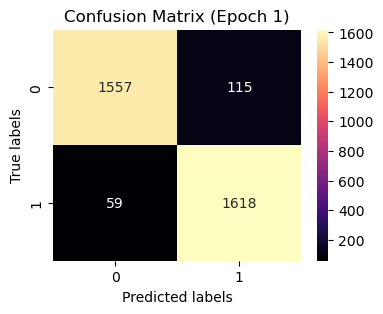

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9480441808700562     │
│        test/auroc         │     0.983536958694458     │
│         test/loss         │     3.959221839904785     │
│          test/r2          │    0.9276633262634277     │
│         test/rmse         │     5.826793193817139     │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 3.47 s, sys: 996 ms, total: 4.47 s
Wall time: 10.9 s


		CURRENT MODEL TESTING - efficientnet_b0


TEST SET



Testing: 0it [00:00, ?it/s]

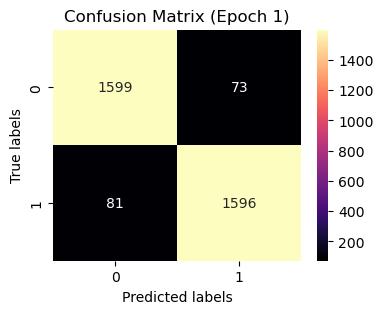

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9540161490440369     │
│        test/auroc         │    0.9872418642044067     │
│         test/loss         │     3.615278959274292     │
│          test/r2          │    0.9352271556854248     │
│         test/rmse         │     5.513746738433838     │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 5.58 s, sys: 1.04 s, total: 6.61 s
Wall time: 13.4 s


		CURRENT MODEL TESTING - efficientnet_b1


TEST SET



Testing: 0it [00:00, ?it/s]

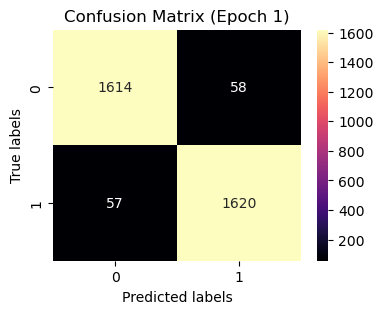

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test/acc          │    0.9656614065170288     │
│        test/auroc         │     0.991269588470459     │
│         test/loss         │     3.494065284729004     │
│          test/r2          │    0.9375114440917969     │
│         test/rmse         │     5.415649890899658     │
└───────────────────────────┴───────────────────────────┘

Predicting: 0it [00:00, ?it/s]

CPU times: user 8.87 s, sys: 1.21 s, total: 10.1 s
Wall time: 13.6 s


In [ ]:
for version in VERSIONS:
    print(f'\n\n\t\tCURRENT MODEL TESTING - {version}\n\n')

    model = UTKFaceModel(
        train_df,
        valid_df,
        test_df,
        learning_rate=LEARNING_RATE,
        batch_size=BATCH_SIZE,
        cm_period=CM_PLOT_PERIOD,
        backbone=version,
    )

    trainer = pl.Trainer()

    print('TEST SET\n')
    trainer.test(model, dataloaders=model.test_dataloader(),
                 ckpt_path=best_ckpts[version])

    %time _ = trainer.predict(model, ckpt_path=best_ckpts[version])

    del model
    gc.collect()
    torch.cuda.empty_cache()

**Evaluation results**

|Model|Inference time on test set (Batch size - 32, device - NVIDIA Tesla P100, test size - 3349)|Test loss|Test Accuracy|Test AUROC|Test R-squared|Test Root Mean Squared Error|
|-----|----------|------|-----|-------------|----------|---------|
|resnet18|11.8s|3.817|0.956|0.988|0.9637|5.914|
|resnet50|14.5s|3.758|0.947|0.986|0.93|5.721|
|mobilenet_v3_large|11.6s|3.827|0.953|0.987|0.928|5.825|
|mobilenet_v3_small|10.9s|3.959|0.948|0.984|0.928|5.827
|efficientnet_b0|13.4s|3.615|0.954|0.987|0.935|5.514|
|efficientnet_b1|13.6s|3.494|0.966|0.991|0.938|5.416|

From this table we can see that overall the best model is efficientnet_b1 as it has best metric results and is faster than resnet50. The fastest model is mobilenet_v3_small, but with worst metrics. Although, the difference in performance isn't significant so any model could be considered optimal in terms of metrics.

## Error analysis

Now we will inspect samples in the test set that the model performed worst on and see what we can learn from it.

### Age error

In [ ]:
model = UTKFaceModel(
    train_df,
    valid_df,
    test_df,
    learning_rate=LEARNING_RATE,
    batch_size=BATCH_SIZE,
    cm_period=CM_PLOT_PERIOD,
    backbone='efficientnet_b1'
)

trainer = pl.Trainer()
pred = trainer.predict(model, ckpt_path=best_ckpts['efficientnet_b1'])

In [ ]:
pred_dict = process_output(pred)

test_df['age_pred'] = pred_dict['age_pred']
test_df['age_error'] = (test_df['age_pred'] - test_df['age']).abs()

test_df['gender_pred'] = pred_dict['gender_pred']
test_df['gender_pred_prob'] = pred_dict['gender_pred_prob']
test_df['gender_error'] = (test_df['gender_pred_prob'] - test_df['gender']).abs()

#### Top 10 test samples with highest age error

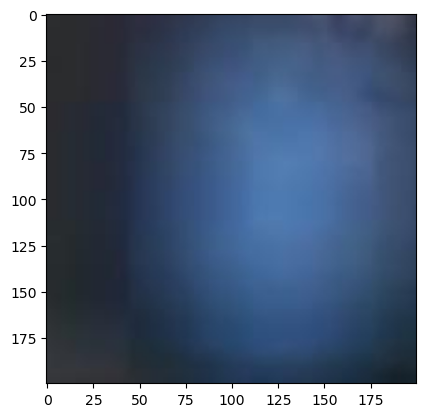

True age: 28, Predicted age: 87
True gender: Male,  Predicted gender: Female
Race: Black



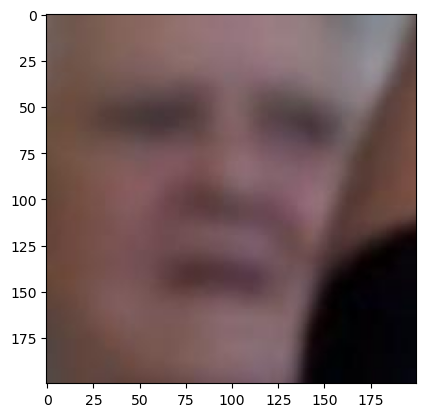

True age: 111, Predicted age: 58
True gender: Female,  Predicted gender: Male
Race: White



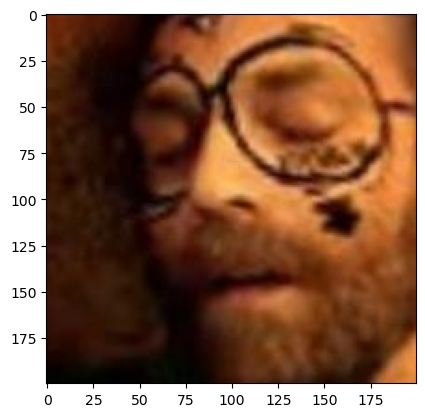

True age: 26, Predicted age: 69
True gender: Male,  Predicted gender: Male
Race: White



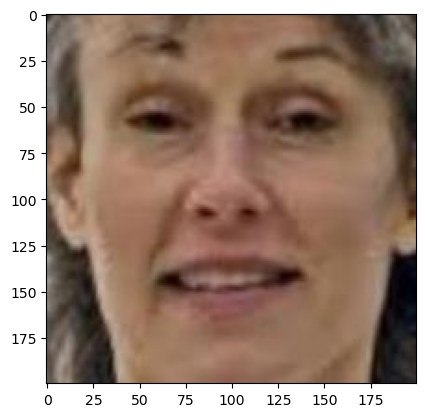

True age: 61, Predicted age: 25
True gender: Female,  Predicted gender: Female
Race: White



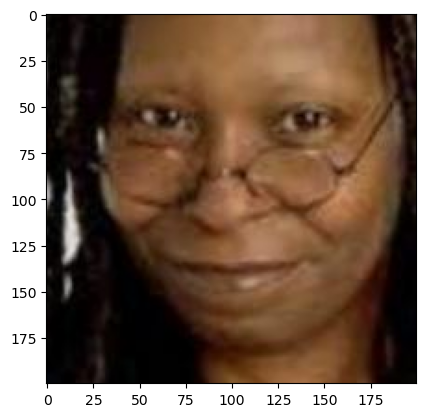

True age: 65, Predicted age: 35
True gender: Female,  Predicted gender: Female
Race: Black



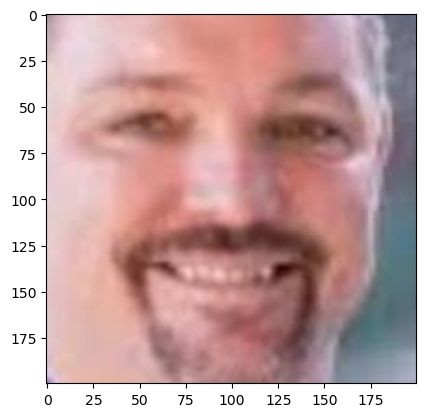

True age: 65, Predicted age: 37
True gender: Male,  Predicted gender: Male
Race: White



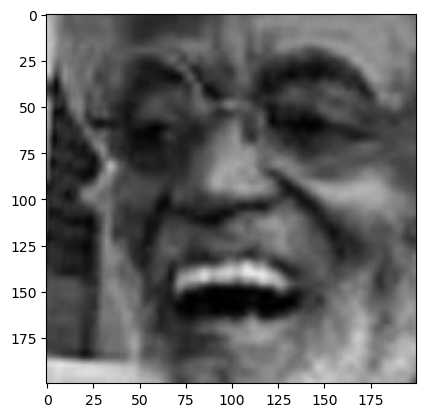

True age: 54, Predicted age: 79
True gender: Male,  Predicted gender: Male
Race: White



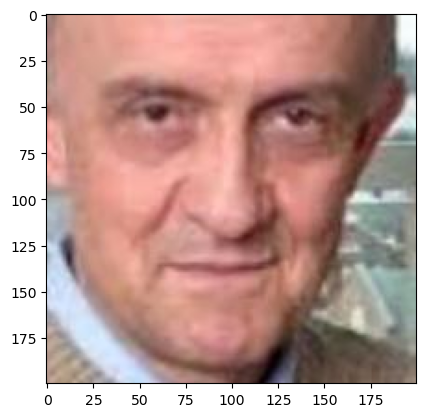

True age: 80, Predicted age: 55
True gender: Male,  Predicted gender: Male
Race: White



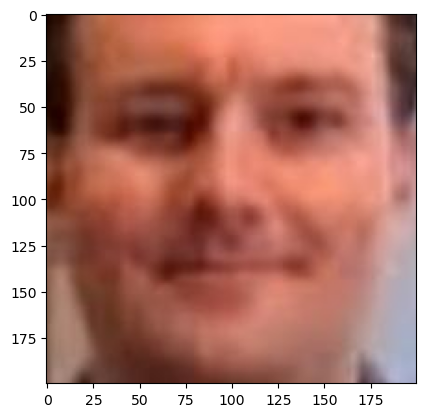

True age: 61, Predicted age: 38
True gender: Male,  Predicted gender: Male
Race: White



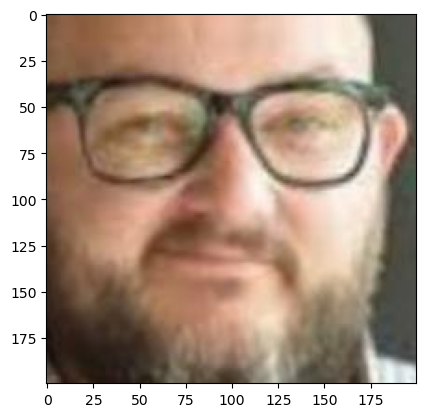

True age: 65, Predicted age: 42
True gender: Male,  Predicted gender: Male
Race: White



In [ ]:
samples = test_df.sort_values('age_error', ascending=False).iloc[:10]

display_samples(samples)

So there are certainly some weird images here like the first one where there isn't any face present in the image. There are also images that are very blurry and one in which a face has markings. Some faces though seem to look younger than they actualy are, so this confuses the model and makes it underestimate the age.

#### Error statistics for different races

In [57]:
test_df['age_error'].describe()

count    3349.000000
mean        3.400418
std         4.281606
min         0.000000
25%         1.000000
50%         2.000000
75%         5.000000
max        59.000000
Name: age_error, dtype: float64

In [66]:
race_dict = {
    0: 'White',
    1: 'Black',
    2: 'Asian',
    3: 'Indian',
    4: 'Others'
}

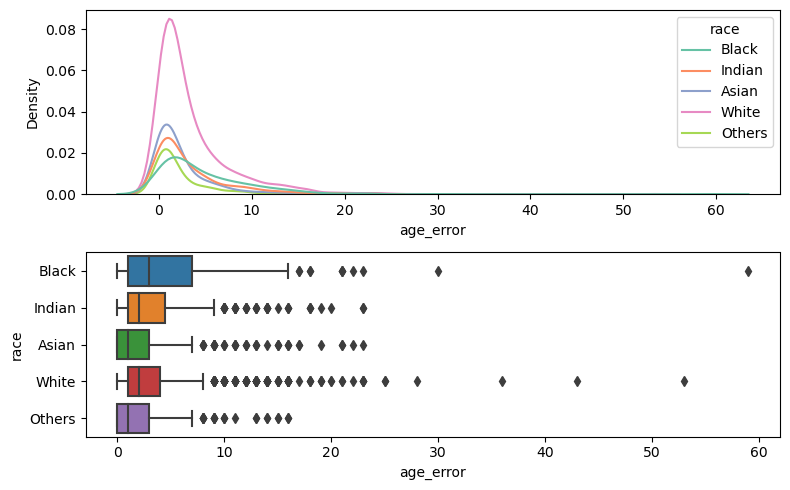

In [67]:
fig, ax = plt.subplots(2,1,figsize=(8,5))

sns.kdeplot(x=test_df['age_error'], hue=test_df['race'].map(race_dict), ax=ax[0], palette='Set2')
sns.boxplot(x=test_df['age_error'], y=test_df['race'].map(race_dict), orient='h', ax=ax[1])
plt.tight_layout()
plt.show()

In [68]:
for i in range(5):
    print(f"Race {race_dict[i]} mean error: {test_df[test_df['race']==i]['age_error'].mean()}\n")

Race White mean error: 3.497677504976775

Race Black mean error: 4.819838056680162

Race Asian mean error: 2.5673624288425048

Race Indian mean error: 3.2815533980582523

Race Others mean error: 2.264705882352941



It seems that the error is the highest among black race samples, which means it is more challenging to estimate the age from a face image for this race.

### Gender error

#### Top 10 test samples with highest gender error

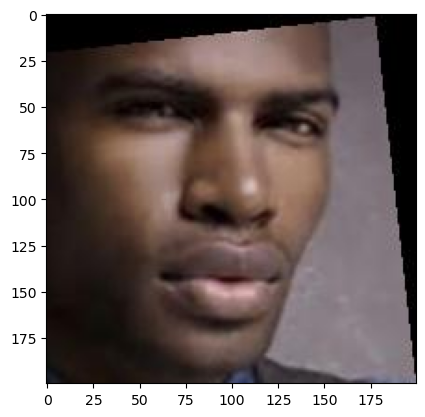

True age: 26, Predicted age: 27
True gender: Female,  Predicted gender: Male
Race: Black



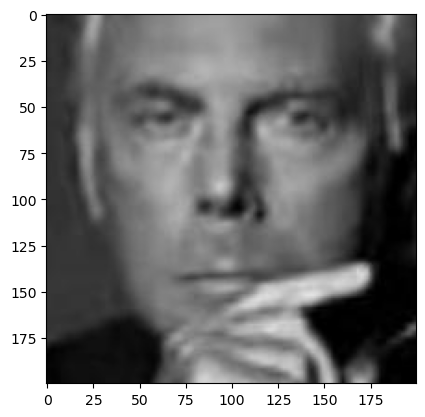

True age: 60, Predicted age: 52
True gender: Female,  Predicted gender: Male
Race: White



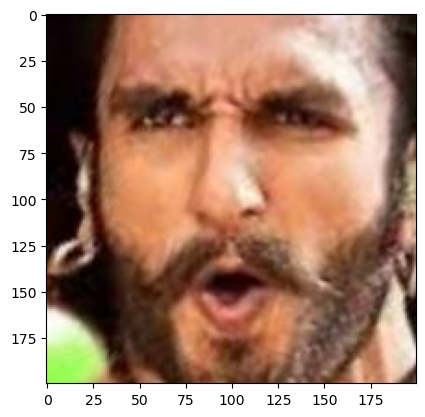

True age: 36, Predicted age: 34
True gender: Female,  Predicted gender: Male
Race: Indian



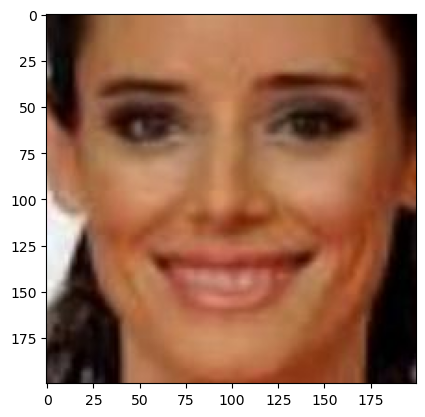

True age: 26, Predicted age: 28
True gender: Male,  Predicted gender: Female
Race: White



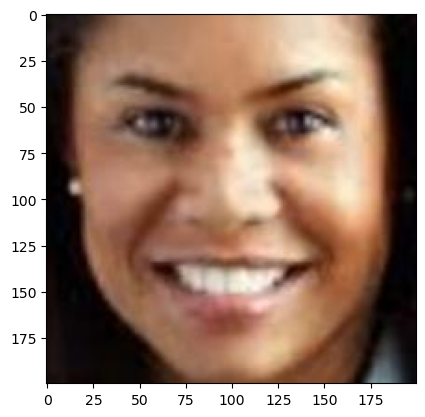

True age: 45, Predicted age: 31
True gender: Male,  Predicted gender: Female
Race: Black



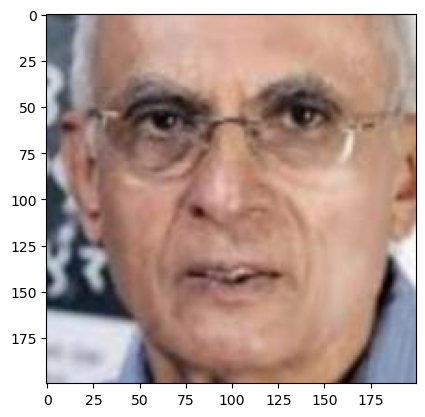

True age: 61, Predicted age: 71
True gender: Female,  Predicted gender: Male
Race: Indian



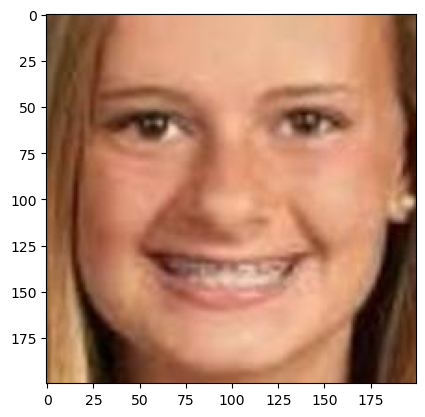

True age: 17, Predicted age: 15
True gender: Male,  Predicted gender: Female
Race: Black



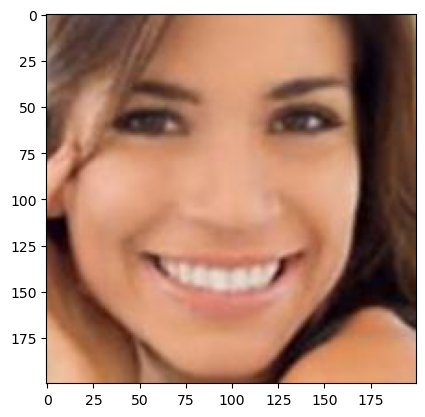

True age: 21, Predicted age: 25
True gender: Male,  Predicted gender: Female
Race: Others like Hispanic, Latino, Middle Eastern



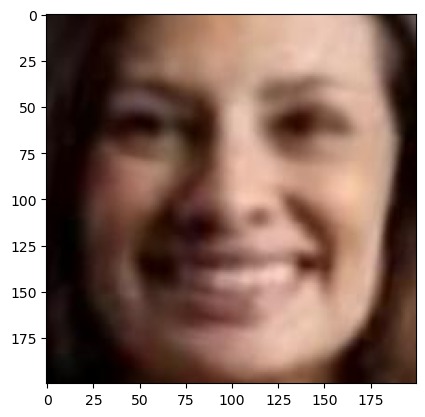

True age: 26, Predicted age: 26
True gender: Male,  Predicted gender: Female
Race: Others like Hispanic, Latino, Middle Eastern



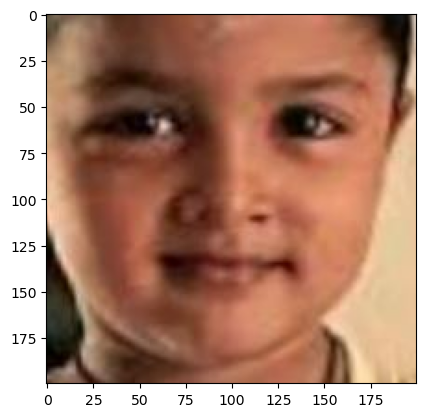

True age: 5, Predicted age: 2
True gender: Male,  Predicted gender: Female
Race: Indian



In [ ]:
samples = test_df.sort_values('gender_error', ascending=False).iloc[:10]

display_samples(samples)

It seems that the biggest problem with gender is that all of these images from the test set are mislabeled, that's why these images had the highest error.

#### Error statistics for different races

In [41]:
test_df['gender_error'].describe()

count    3.349000e+03
mean     4.062067e-02
std      1.614668e-01
min      0.000000e+00
25%      4.768372e-07
50%      2.963400e-05
75%      1.560867e-03
max      1.000000e+00
Name: gender_error, dtype: float64

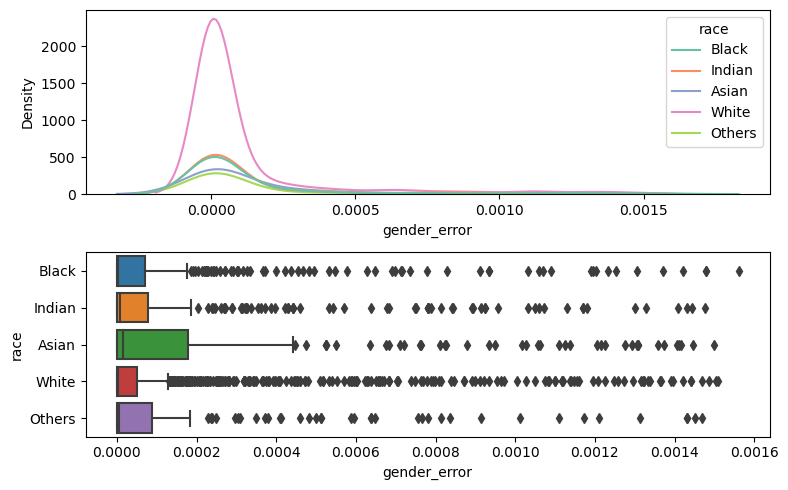

In [69]:
fig, ax = plt.subplots(2,1,figsize=(8,5))

df = test_df[test_df['gender_error']<=test_df['gender_error'].quantile(0.75)]

sns.kdeplot(x=df['gender_error'], hue=df['race'].map(race_dict), ax=ax[0], palette='Set2')
sns.boxplot(x=df['gender_error'], y=df['race'].map(race_dict), orient='h', ax=ax[1])
plt.tight_layout()
plt.show()

In [70]:
for i in range(5):
    print(f"Race {race_dict[i]} mean error: {test_df[test_df['race']==i]['gender_error'].mean()}\n")

Race White mean error: 0.03401815639292133

Race Black mean error: 0.04401763866772411

Race Asian mean error: 0.06004715577529768

Race Indian mean error: 0.03473497682668287

Race Others mean error: 0.04410191262556866



We can see that the mean error for gender is highest for the asian race. In both the age and gender cases it would be beneficial to have more face samples of races that have the highest errors in the dataset.

### Predictions on random samples

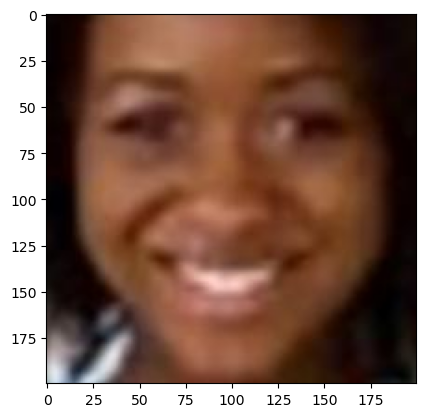

True age: 24, Predicted age: 25
True gender: Female,  Predicted gender: Female
Race: Black



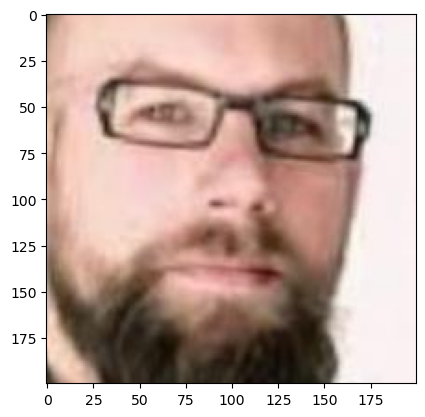

True age: 32, Predicted age: 32
True gender: Male,  Predicted gender: Male
Race: White



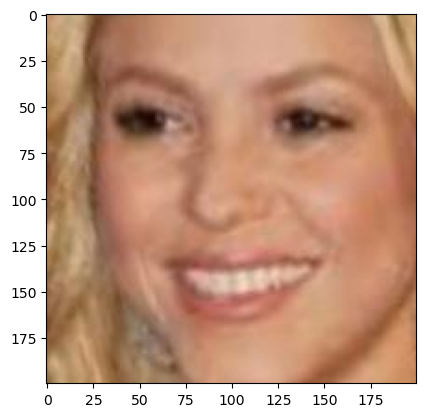

True age: 26, Predicted age: 26
True gender: Female,  Predicted gender: Female
Race: White



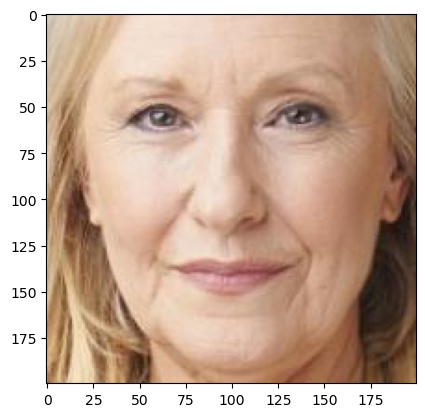

True age: 64, Predicted age: 64
True gender: Female,  Predicted gender: Female
Race: White



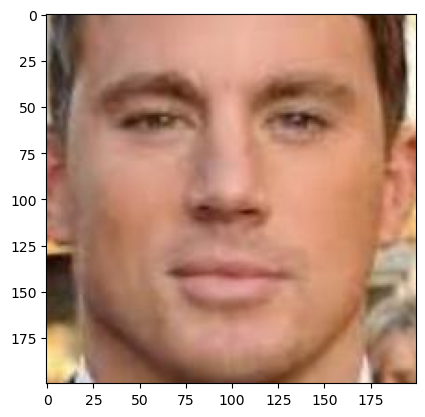

True age: 29, Predicted age: 29
True gender: Male,  Predicted gender: Male
Race: White



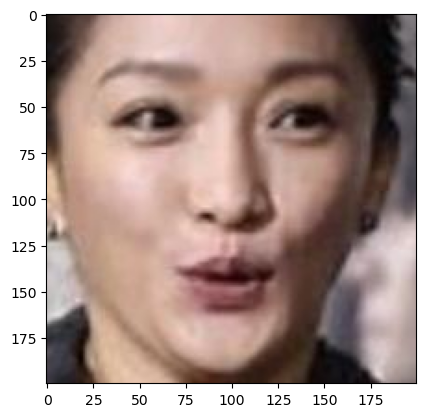

True age: 32, Predicted age: 29
True gender: Female,  Predicted gender: Female
Race: Asian



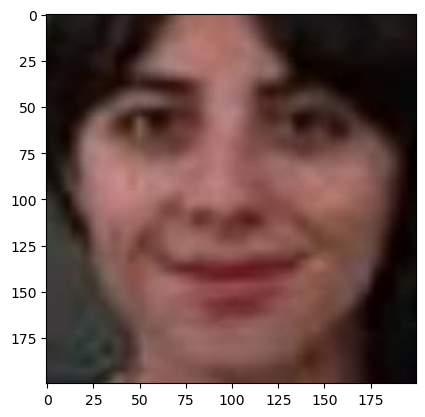

True age: 29, Predicted age: 28
True gender: Female,  Predicted gender: Female
Race: White



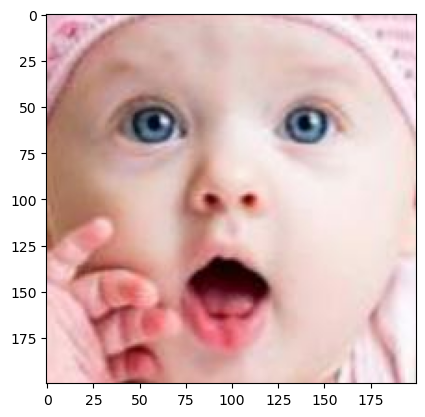

True age: 1, Predicted age: 1
True gender: Female,  Predicted gender: Female
Race: White



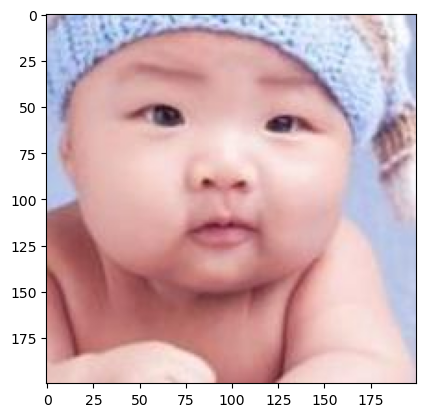

True age: 1, Predicted age: 1
True gender: Male,  Predicted gender: Female
Race: Asian



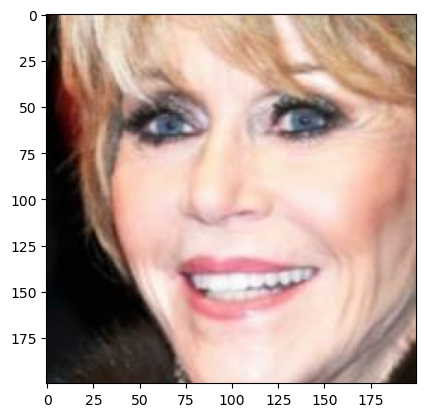

True age: 67, Predicted age: 68
True gender: Female,  Predicted gender: Female
Race: White



In [21]:
samples = test_df.sample(10)

display_samples(samples)

Observing random samples from the test set we can see that the model performs quite well, but there could be problems with age overestimation.

## Model interpretability with LIME

In [ ]:
def prediction_function_gender(images: np.ndarray) -> np.ndarray:
    batch = torch.stack(
        tuple(torchvision.transforms.ToTensor()(i) for i in images),
        dim=0
    )

    batch = model.mtl_model.weights.transforms(antialias=True)(batch)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    batch = batch.to(device)

    pred = model(batch)

    return torch.nn.functional.sigmoid(pred[1]).detach().cpu().numpy()


def prediction_function_age(images: np.ndarray) -> np.ndarray:
    batch = torch.stack(
        tuple(torchvision.transforms.ToTensor()(i) for i in images),
        dim=0
    )

    batch = model.mtl_model.weights.transforms(antialias=True)(batch)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    batch = batch.to(device)

    pred = model(batch)

    return pred[0].detach().cpu().numpy()


def explain_image(img: np.ndarray, prediction_fcn) -> None:
    explainer = LimeImageExplainer()
    explanation = explainer.explain_instance(
        np.array(img),
        prediction_fcn,
        num_samples=1000
    )

    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0],
        positive_only=False,
        num_features=10,
        hide_rest=False
    )

    img_boundry2 = mark_boundaries(temp/255.0, mask)

    plt.imshow(img_boundry2)
    plt.show()

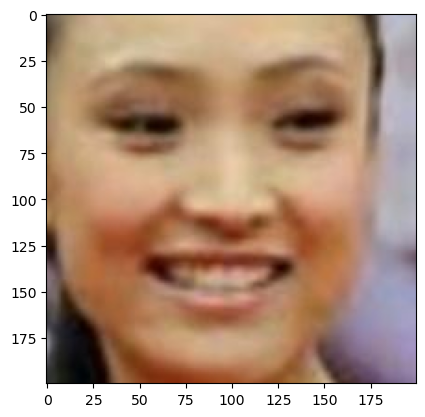


True age: 26,  Predicted age: 29
True gender: Female,  Predicted gender: Female
Race: Asian

GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

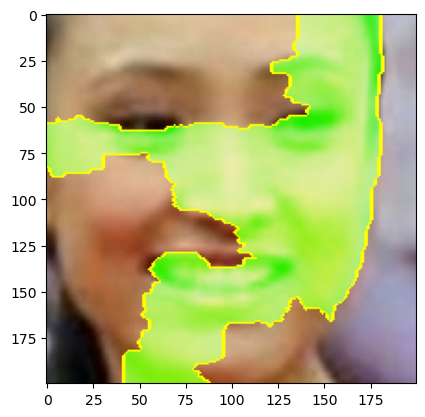


AGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

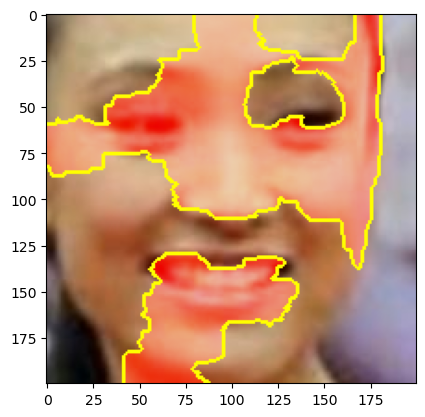

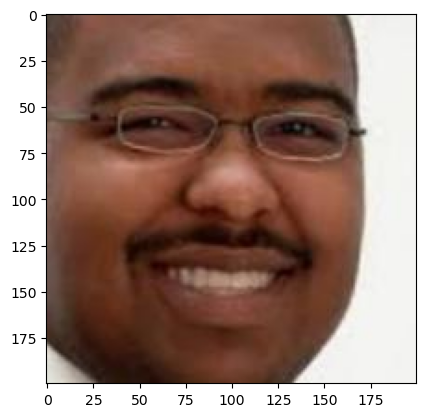


True age: 27,  Predicted age: 33
True gender: Male,  Predicted gender: Male
Race: Black

GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

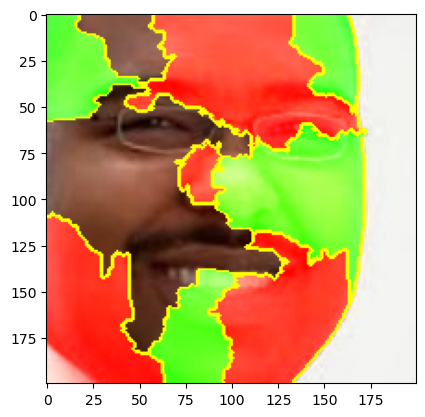


AGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

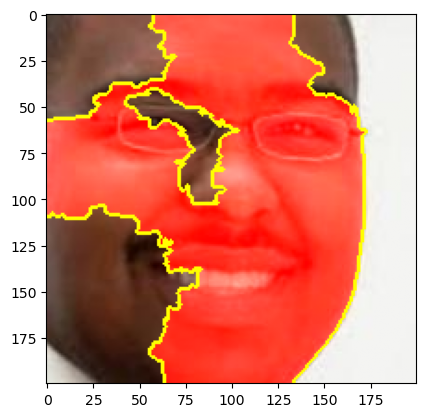

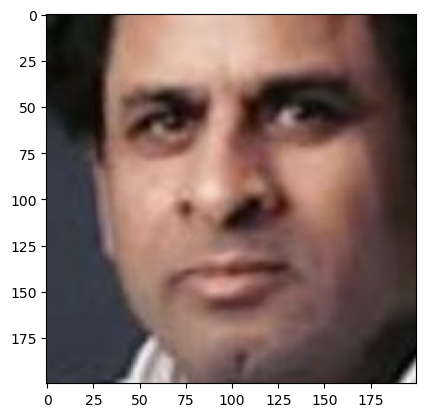


True age: 36,  Predicted age: 36
True gender: Male,  Predicted gender: Male
Race: Indian

GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

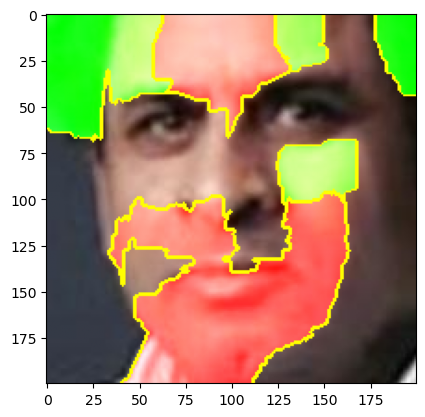


AGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

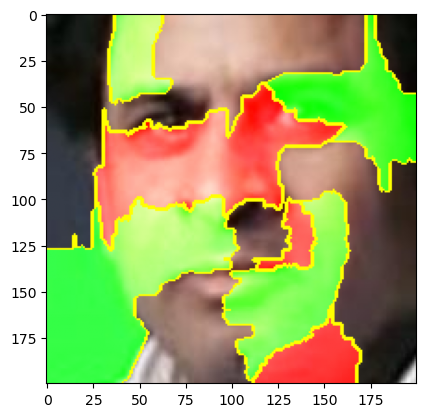

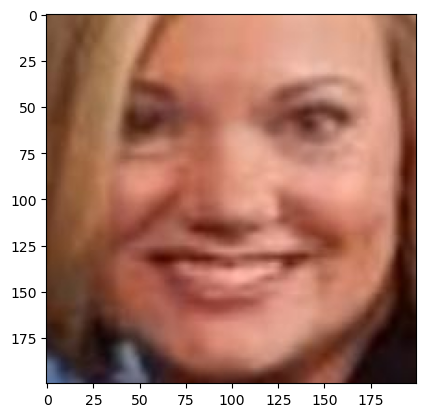


True age: 27,  Predicted age: 39
True gender: Female,  Predicted gender: Female
Race: White

GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

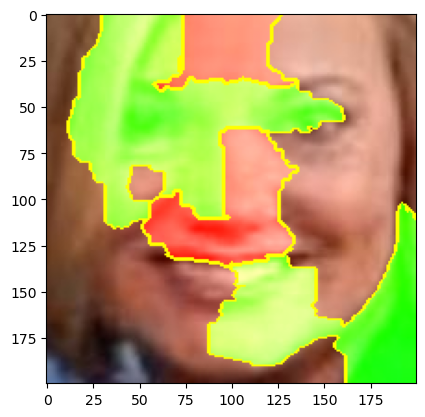


AGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

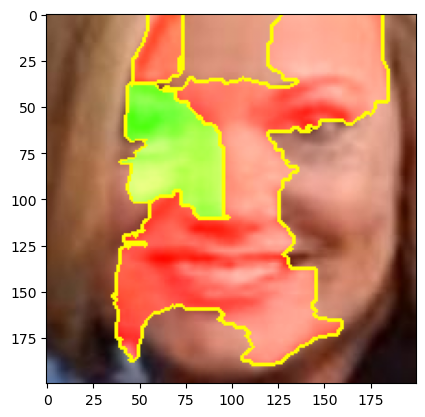

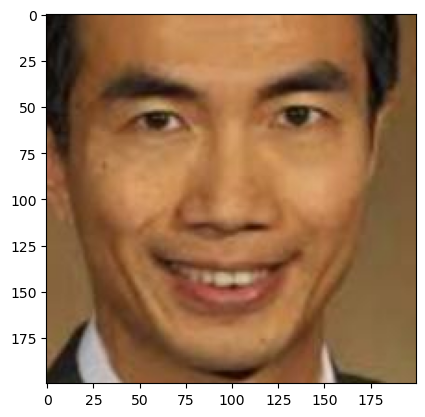


True age: 42,  Predicted age: 41
True gender: Male,  Predicted gender: Male
Race: Asian

GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

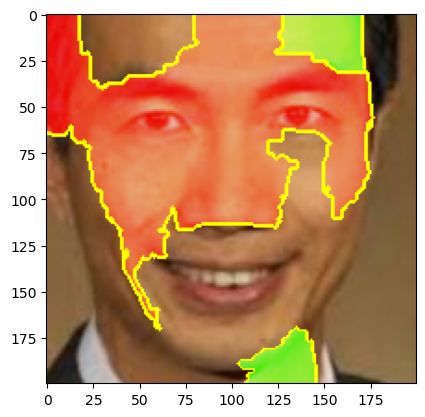


AGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)


  0%|          | 0/1000 [00:00<?, ?it/s]

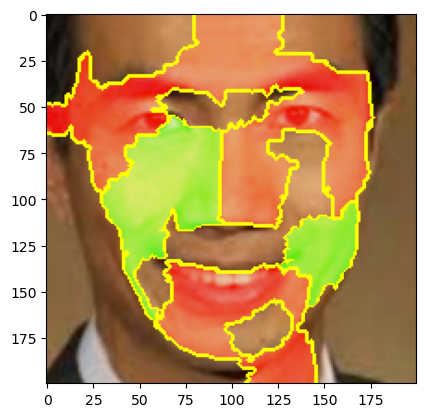

In [ ]:
samples = test_df.sample(5)

for sample in samples.iterrows():
    img = plt.imread(sample[1]['path'])
    plt.imshow(img)
    plt.show()

    print(f"\nTrue age: {sample[1]['age']}, ",
          f"Predicted age: {sample[1]['age_pred']}")
    print(f"True gender: {gender_dict[int(sample[1]['gender'])]}, ",
          f"Predicted gender: {gender_dict[int(sample[1]['gender_pred'])]}")
    print(f"Race: {race_dict[int(sample[1]['race'])]}\n")

    print('GENDER LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)')
    explain_image(img, prediction_function_gender)

    print('\nAGE LIME EXPLAINER (Green - positive effect to output, Red - negative effect to output)')
    explain_image(img, prediction_function_age)

As we can see the model definitely focuses on the face when making predictions. For example in the first image gender lime explainer there is a green segment on the woman's face overlaping eyes, cheek, nose and mouth indicating that these parts were influential in predicting that it was a female, meaning making the prediction output close to 1. Also in the fourth image a green segement is also overlaping parts of woman's hair which makes sense.

In terms of age the model seems to focus on parts of the face where wrinkles could be visible, which might be a good indication of age. This is especialy appearent in the last image.

Overall, there are patterns where it makes sense why a model would focus on a certain part of an image, but there might be certain things that are not obvious, that are learned by the model. For example it might not be entirely clear how humans can classify gender so effortlessly.

## Summary and ethical issues

Again here is a table summarizing model evaluation results:

|Model|Inference time on test set (Batch size - 32, device - NVIDIA Tesla P100, test size - 3349)|Test loss|Test Accuracy|Test AUROC|Test R-squared|Test Root Mean Squared Error|
|-----|----------|------|-----|-------------|----------|---------|
|resnet18|11.8s|3.817|0.956|0.988|0.9637|5.914|
|resnet50|14.5s|3.758|0.947|0.986|0.93|5.721|
|mobilenet_v3_large|11.6s|3.827|0.953|0.987|0.928|5.825|
|mobilenet_v3_small|10.9s|3.959|0.948|0.984|0.928|5.827
|efficientnet_b0|13.4s|3.615|0.954|0.987|0.935|5.514|
|efficientnet_b1|13.6s|3.494|0.966|0.991|0.938|5.416|

From which efficientnet_b1 could be considered optimal model, but its results do not differ very much from the fastest mobilenet_v3_small model.

These could be improvements to the dataset based on the insights learned from the error analysis:
- Relabel mislabeled images for gender;
- Remove very blurry images;
- Remove images that do not contain any faces or have occlusions;

**Ethical issues**

There could be following ethical issues in using this model:
- Age over/under-estimation - People might be made older in certain situations than they actualy are. Though under-estimation might be less of a concern for making people feel bad, but there are use cases where this could be a problem, for example predicting whether or not a person is over 18.
- Gender misclassification - This could be a problem where gender classification is important for some use case. Some men might have a very feminine face in which case they might be classified as females. Moreover, misclassification would increase with young children as they do not yet have distinct gender features.
- The predictions could be worse for under-represented people in the dataset as it was observed in the error analysis. Where the error was higher for the black race in terms of age and asian race in terms of gender.

Theses issues generaly could be mitigated by collecting more diverse images, but also by avoiding usage of this model in certain domains. For example these issues wouldn't be important when using this model in surveillance where basic information on a random person could be obtained and then used by law enforcement when necessary. Although, if these predictions would be used in a consumer product or medicine for what ever reason then there could be various finantial, legal, health, psychological problems due to incorrect predictions.